# T040 · Analyzing molecular dynamics simulations

**Note:** This talktorial is a part of TeachOpenCADD, a platform that aims to teach domain-specific skills and to provide pipeline templates as starting points for research projects.

Authors:

- Ahmed Lamloum, CADD seminar 2025, Saarland University 
- Kriti Maurya, CADD seminar 2025, Saarland University
- Guillermo Pérez-Hernández, Charité Universitätsmedizin Berlin, 2025
- Andrea Volkamer, 2021, [Volkamer Lab, Charité](https://volkamerlab.org/) 

## Aim of this talktorial

In this talktorial, we will analyze the molecular dynamics (MD) of a G protein-coupled receptor (GPCR) e.g. different activation states, different ligands, different mutants, etc. as well as in complex with a ligand, to explore its structural dynamics. Key analysis methods, including animated visualization, structural alignment, RMSD (Root Mean Square Deviation), and RMSF (Root Mean Square Fluctuation) calculations (among others), will provide foundational insights into GPCR conformational changes.

### Contents in *Theory*

- An Overview of GPCR movements
    - Biological background
       - GPCR Structure
       - Function of GPCRs
       - GPCR Activation Mechanism
       - Types of GPCRs
       - GPCR Dynamics
       - Drug Discovery and GPCRs
- An Overview of GPCR Movement: Dynamic
       - Types of Motion
       - Conformational States
       - Binding Pocket Dynamics
- Active vs Inactive state
       - Atomic-Level Motions
       - Visualization of Dynamics
       - Mobility of Transmembrane Helix 6 (TM6)
       - Conformational Transitions
       - Atomic-Level Motions
- Importance of GPCR Dynamics in Drug Discovery
- Analyzing GPCR Simulations from GPCRmd 
    - Root mean square deviation
    - Root mean square fluctuation
    - contact analysis
    - Secondary structure
- Execution time: 149.934 seconds
- I have used the [talktorial template](https://github.com/volkamerlab/teachopencadd/blob/master/teachopencadd/talktorials/T000_template/talktorial.ipynb) and followed the content and formatting suggestions there.
- Packages
    - NGLview: We used it to visualize trajectories.
    - mdtraj: 3D visualization for detailed structure analysis.
    - mdcioa : Designed to study GPCR simulations, particularly using GPCRmd database.
- Data:
    - Beta-2 adrenergic receptor: [4QKX](https://www.gpcrmd.org/dynadb/dynamics/id/82/) (active) and [3NYA](https://www.gpcrmd.org/dynadb/dynamics/id/100/) (inactive).
    - Mu-type opioid receptor: [5C1M](https://www.gpcrmd.org/dynadb/dynamics/id/151/) (active) and [4DKL](https://www.gpcrmd.org/dynadb/dynamics/id/61/) (inactive).

### Contents in *Practical*


**References:**

1. MDTraj: McGibbon, R. T., Beauchamp, K. A., Harrigan, M. P., Klein, C., Swails, J. M., Hernández, C. X., ... & Pande, V. S. (2015). MDTraj: A modern open library for the analysis of molecular dynamics trajectories. Biophysical Journal, 109(8), 1528-1532. https://doi.org/10.1016/j.bpj.2015.08.015

2. NGLView: Nguyen, H., Case, D. A., & Rose, A. S. (2018). NGLview–interactive molecular graphics for Jupyter notebooks. Bioinformatics, 34(7), 1241-1242. https://doi.org/10.1093/bioinformatics/btx789

3. GPCR Dynamics: Latorraca, N. R., Venkatakrishnan, A. J., & Dror, R. O. (2017). GPCR dynamics: structures in motion. Chemical Reviews, 117(1), 139-155. https://doi.org/10.1021/acs.chemrev.6b00177

4. GPCRmd: Rodríguez-Espigares, I., Torrens-Fontanals, M., Tiemann, J. K., Aranda-García, D., Ramírez-Anguita, J. M., Stepniewski, T. M., ... & Selent, J. (2020). GPCRmd uncovers the dynamics of the 3D-GPCRome. Nature Methods, 17(8), 777-787. https://doi.org/10.1038/s41592-020-0884-y

5. TeachOpenCADD Talktorial 17: Advanced NGLView Usage. https://projects.volkamerlab.org/teachopencadd/talktorials/T017_advanced_nglview_usage.html

6. TeachOpenCADD Talktorial 20: Analyzing Molecular Dynamics Simulations. https://projects.volkamerlab.org/teachopencadd/talktorials/T020_analyzing_md_simulations.html

## Theory

G protein-coupled receptors (GPCRs) are critical targets in drug discovery due to their role in various physiological processes and diseases. The dynamics of GPCRs, characterized by their ability to undergo conformational changes, are essential for understanding their activation mechanisms and signaling pathways. These receptors can exist in multiple conformational states, and their binding pockets exhibit significant flexibility, which influences ligand interactions and receptor activation. Insights into GPCR dynamics enable the design of drugs that can selectively stabilize specific receptor conformations, facilitating the development of targeted therapies that modulate GPCR activity with greater precision. Additionally, understanding the relationship between receptor dynamics and biased signaling can guide the rational design of ligands that achieve desired therapeutic outcomes while minimizing side effects.

### Biological Background

#### Introduction

- Definition and Classification: GPCRs are a large family of membrane proteins that play a crucial role in cellular communication. They are classified based on their structure and the type of ligands they bind to, including rhodopsin-like receptors, secretin-like receptors, and others.

- Overview of Their Role: GPCRs are the largest class of drug targets, with approximately one-third of all marketed drugs acting on these receptors. They are involved in various physiological processes, making them critical for maintaining homeostasis.

#### Structure of GPCRs

- General Architecture: GPCRs typically consist of seven transmembrane (TM) helices that span the cell membrane. These helices are connected by extracellular and intracellular loops, forming a pocket for ligand binding.

- Extracellular and Intracellular Loops: The extracellular loops are involved in ligand recognition, while the intracellular loops interact with G proteins and other signaling partners. The structure is essential for the receptor's ability to transduce signals across the membrane.

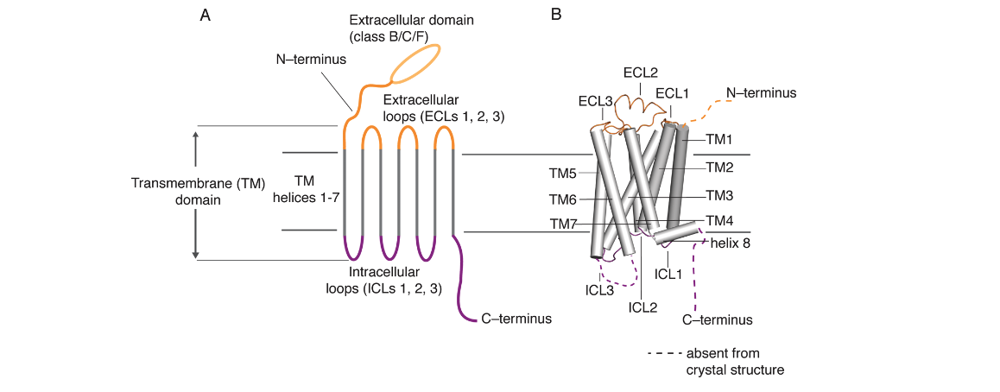

#### Function of GPCRs

- Mechanism of Signal Transduction: GPCRs initiate signaling cascades upon ligand binding, leading to cellular responses. This process involves conformational changes in the receptor that activate associated G proteins.

- Role in Cellular Communication: GPCRs detect a wide range of external signals, including hormones, neurotransmitters, and sensory stimuli, and translate these signals into intracellular actions.

- Types of Signals: GPCRs respond to diverse molecules, from small ligands like neurotransmitters to larger proteins like chemokines, influencing various physiological functions.

####  GPCR Activation Mechanism

- Ligand Binding and Conformational Changes: When a ligand binds to a GPCR, it induces a conformational change that activates the receptor. This change is crucial for the receptor's ability to interact with G proteins.

- Transition from Inactive to Active States: The inactive state of a GPCR is characterized by a compact conformation, while the active state involves significant rearrangements of the TM helices, allowing G protein coupling.

- Role of G Proteins: Activated GPCRs interact with G proteins, which are heterotrimeric complexes that transmit signals to downstream effectors, such as enzymes and ion channels.

####  Types of GPCRs

- Classification Based on Ligand Type: GPCRs can be classified into several families based on their structural features and the ligands they bind.
For example, rhodopsin-like receptors are involved in vision, while secretin-like receptors are involved in hormone signaling.

- Differences in Signaling Pathways: Each GPCR family can activate distinct signaling pathways, leading to varied physiological responses. This diversity allows for fine-tuned regulation of cellular functions.

####  GPCR Dynamics

- Importance of Conformational Flexibility: GPCRs are not static; they exhibit dynamic behavior that is essential for their function. This flexibility allows them to adopt multiple conformations, which is critical for ligand binding and signal transduction.

- Overview of Dynamic Processes: GPCRs undergo conformational changes in response to ligand binding, which can include allosteric modulation where ligands bind to sites other than the primary binding site, influencing receptor activity.

- Techniques Used to Study GPCR Dynamics: Advanced techniques such as X-ray crystallography, nuclear magnetic resonance (NMR) spectroscopy, and molecular dynamics simulations are employed to study the dynamic behavior of GPCRs.

####  Drug Discovery and GPCRs

- Overview of GPCR-Targeted Drug Discovery: The unique properties of GPCRs make them attractive targets for drug discovery. Researchers aim to develop compounds that can selectively modulate GPCR activity.

- Challenges in Targeting GPCRs: The dynamic nature of GPCRs presents challenges in drug design, as static models may not accurately represent receptor behavior. Understanding the full range of receptor dynamics is essential for successful drug development.

- Examples of Successful GPCR-Targeted Therapies: Numerous drugs, such as beta-blockers and antipsychotics, target GPCRs, demonstrating the therapeutic potential of modulating these receptors.

### An Overview of GPCR Movement: Dynamic
#### Types of Motion:

- GPCRs exhibit both localized and global motions. Localized motions occur on very short timescales (femtoseconds to nanoseconds) and involve fluctuations in bond lengths and angles, as well as changes in the rotamer states of solvent-exposed amino acid side chains.

- In contrast, global motions involve larger regions of the protein and occur over longer timescales (nanoseconds to milliseconds). These motions include changes in the orientation of helices, kinking of helices, and rearrangement of tightly packed side chains within the protein's interior.

#### Conformational States:

- The term conformation refers to a specific three-dimensional arrangement of atoms in a GPCR at a given moment. Over time, GPCRs can adopt an essentially infinite number of conformations, which tend to cluster into groups known as conformational states.

- GPCRs typically transition quickly among conformations within a single conformational state but move more slowly between different conformational states. Importantly, GPCRs can spontaneously transition among multiple conformational states even in the absence of ligand binding or environmental changes.

#### Binding Pocket Dynamics: 

- The binding pocket of GPCRs is highly flexible and its geometry can vary significantly between different conformational states. This flexibility is crucial for accommodating various ligands and influences the receptor's ability to engage with different signaling partners.

- The dynamic nature of the binding pocket means that relying on a single static structure for drug design may only identify a subset of potential ligands. Considering multiple receptor structures can enhance the diversity of identified binding ligands.


### Active vs Inactive state

Transmembrane helices 2 (TM2) and 6 (TM6) of G protein-coupled receptors (GPCRs) play crucial roles in the transition between the active and inactive states of these receptors. Their conformational dynamics are essential for understanding how GPCRs function in signal transduction.

In G protein-coupled receptors (GPCRs), the inactive state is characterized by a compact conformation where transmembrane helices, particularly TM2 and TM6, are positioned to stabilize the receptor and prevent signaling; TM6 forms an "ionic lock" with TM3, inhibiting G protein coupling. Upon ligand binding, especially by an agonist, the receptor transitions to the active state, where TM2 and TM6 undergo significant conformational changes—TM2 shifts to facilitate ligand interaction, and TM6 tilts and moves outward, breaking the ionic lock. This transition allows the receptor to engage with G proteins, initiating intracellular signaling pathways.

##### The diagram, illustrates the dynamic behavior of GPCRs, specifically focusing on the transitions between active and inactive states of the β2-adrenergic receptor (β2AR) as revealed through molecular dynamics (MD) simulations.

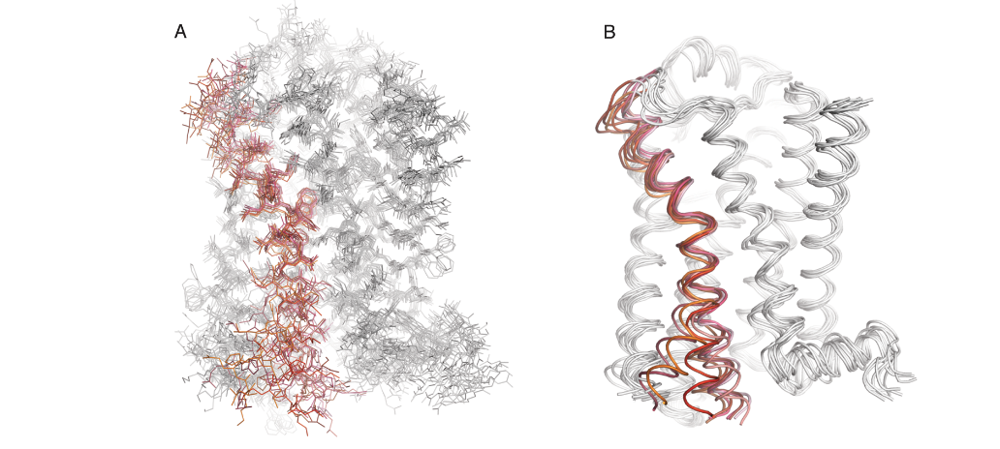

##### A: Atomic-Level Motions:

- The figure presents representative frames from MD simulations that capture the atomic-level motions of the GPCR during its transition. This highlights how the receptor changes conformation over time.

##### B: Visualization of Dynamics:

- In the figure, all non-hydrogen atoms are represented as lines, while the protein backbone is depicted as ribbons. This visual representation helps to emphasize the structural changes occurring within the receptor.

##### Mobility of Transmembrane Helix 6 (TM6):

- TM6 is specifically colored red to indicate its high degree of mobility during the transition between active and inactive states. This suggests that TM6 plays a crucial role in the conformational changes that GPCRs undergo in response to ligand binding.

##### Conformational Transitions:

- The figure effectively demonstrates how GPCRs are not static entities but are instead in constant motion, transitioning between different conformational states. This dynamic behavior is essential for their function in signal transduction.

### Importance of GPCR Dynamics in Drug Discovery

1. Binding Pocket Flexibility: The binding pockets of GPCRs exhibit substantial flexibility, which can vary between different conformational states. This variability means that a single static structure may not represent all possible binding interactions, making it necessary to consider multiple conformations during drug design to identify a broader range of potential ligands.

2. Advancements in Structure-Based Drug Design: Recent breakthroughs in GPCR crystallography have facilitated the adoption of structure-based drug design methodologies. However, to fully exploit these methods, a comprehensive understanding of the dynamic properties of GPCRs is essential.

3. Integration of Computational and Experimental Approaches: The combination of computational methods, such as molecular dynamics simulations, with experimental techniques has enhanced the understanding of GPCR dynamics. This integration allows for the validation of computational predictions and informs the design of more effective drugs.

4. Challenges and Opportunities: Despite the advancements, there are still significant challenges in fully understanding GPCR dynamics and their implications for drug discovery. Addressing these challenges presents opportunities for developing novel therapeutics targeting GPCRs, which are involved in numerous physiological processes and diseases.

### Analyzing GPCR Simulations from GPCRmd 


#### Root mean square deviation RMSD

RMSD (root mean square deviation) represents the deviation of a coordinate set from a reference set. In molecular dynamics, the reference set is represented by the starting point of the simulations and so the calculation of RMSD allows us to observe how these coordinates evolve with respect to the starting point.

The Root Mean Square Deviation (RMSD) is a statistical measure used to quantify the deviation of a set of points (such as atomic positions) from a reference structure. The formula for RMSD is:

RMSD= √1/N​(xi​−yi​)^2​




Where:

- N is the number of atoms being compared.

- xi​ represents the position of the i-th atom in the reference structure.

- yi​ represents the position of the i-th atom in the structure being analyzed.


#### Root mean square fluctuation RMSF

RMSF (root mean square fluctuation) does not indicate positional differences in the time, but rather measures the individual flexibility of residues, thus how much a particular residue moves during a simulation.


Root Mean Square Fluctuation (RMF) is a measure used in molecular dynamics simulations to quantify the flexibility of individual atoms or residues in a protein over time. It provides insight into how much the position of an atom or residue varies from its average position during the simulation.

The formula for calculating RMSF for a specific atom or residue is:

RMSF=√1/T​(xt​−⟨x⟩)^2​

Where:

- T is the total number of time frames in the simulation.

- xt​ is the position of the atom or residue at time t.

- ⟨x⟩ is the average position of the atom or residue over the entire simulation.

RMSF is particularly useful for identifying regions of a protein that are more flexible or dynamic, which can be important for understanding function, interactions, and potential drug binding sites. In the context of GPCRs, RMSF can help elucidate how different conformational states affect receptor dynamics and signaling .

## Practical


### Import Required Packages for MD Analysis
In this cell, we import all necessary Python packages for molecular dynamics analysis, including MDTraj for trajectory handling, MDCiao for GPCR-specific analysis, and visualization tools.

In [1]:
from pathlib import Path
%matplotlib inline

import mdtraj as md
import numpy as np
import matplotlib.pyplot as plt
import mdciao 
import nglview

### Loading trajectory using MdTraj
Load molecular dynamics trajectories for the Beta-2 Adrenergic Receptor in both active and inactive states for conformational analysis.

In [2]:
HERE = Path(_dh[-1])
DATA = HERE / "data"
# ref: T020_talktorial.ipynb cell [2]

\
**For this analysis, we used the following examples, which can be modified as needed.**

- **Beta-2 adrenergic receptor:** [4QKX](https://www.gpcrmd.org/dynadb/dynamics/id/82/) (active) and [3NYA](https://www.gpcrmd.org/dynadb/dynamics/id/100/) (inactive).
- **Mu-type opioid receptor:** [5C1M](https://www.gpcrmd.org/dynadb/dynamics/id/151/) (active) and [4DKL](https://www.gpcrmd.org/dynadb/dynamics/id/61/) (inactive).

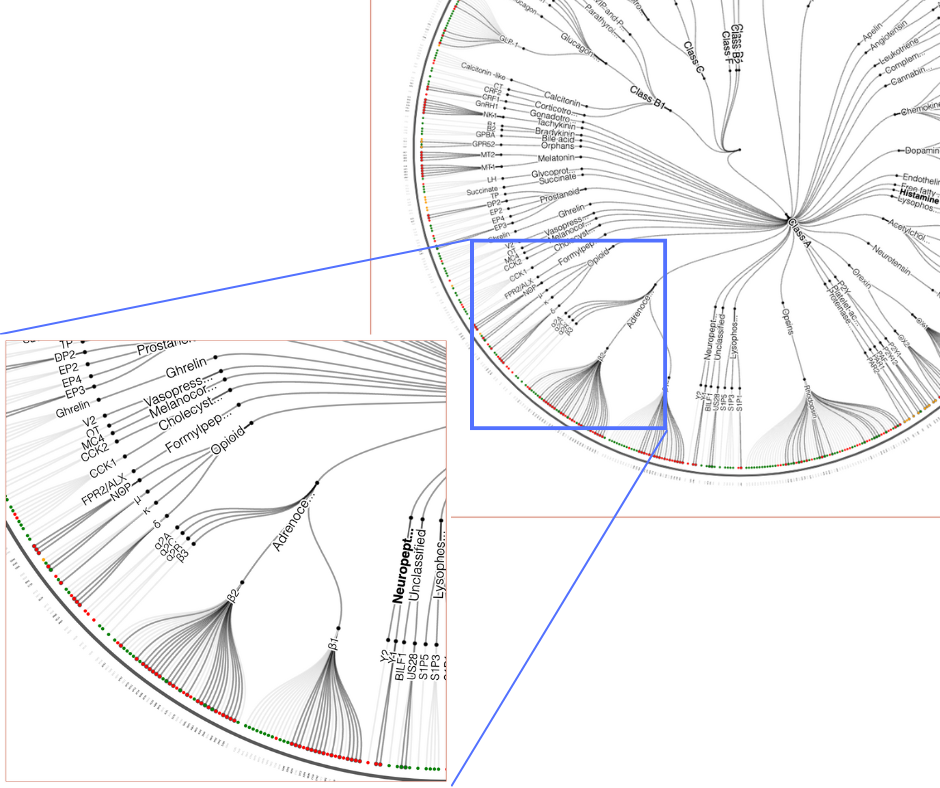

In [3]:
# trajectory files
traj1 = {
    "active": 
        ["10799_trj_82_4QKX.xtc", "10804_dyn_82_4QKX.pdb"],
    "inActive":
        ["10953_trj_100_3NYA.xtc" , "10957_dyn_100_3NYA.pdb"]
        }
traj2 = {
    "active":
        ["11423_trj_151_5C1M.xtc" , "11426_dyn_151_5C1M.pdb"],
    "inActive":
        ["10612_trj_61_4DKL.xtc" , "10616_dyn_61_4DKL.pdb"]
        }

#### Beta-2 adrenergic receptor
Load molecular dynamics trajectories for the Beta-2 Adrenergic Receptor in both active and inactive states for conformational analysis.

In [4]:
traj1_active = md.load(DATA / traj1["active"][0], top= DATA / traj1["active"][1])  
traj1_inActive = md.load(DATA / traj1["inActive"][0], top= DATA / traj1["inActive"][1])  

#### Mu-type opioid receptor
Load molecular dynamics trajectories for the Mu-type opioid receptor in both active and inactive states for comparative analysis.

In [5]:
traj2_active = md.load(DATA / traj2["active"][0], top= DATA / traj2["active"][1]) 
traj2_inActive = md.load(DATA / traj2["inActive"][0], top= DATA / traj2["inActive"][1]) 

**Create a Dictionary to Facilitate the Subsequent Analysis**

In [6]:
trajectories = {
    "traj1_active" : traj1_active, 
    "traj1_inActive" : traj1_inActive,  
    "traj2_active" : traj2_active,
    "traj2_inActive" : traj2_inActive,
}

### Eliminate water, ions and lipids from the trajectory data 
Remove water, ions, and lipids from the trajectory data to focus on protein dynamics.

In [7]:
# Iterate to select only protein
for key, traj in trajectories.items():
    trajectories[key] = traj.atom_slice(traj.topology.select('protein'))

### Visualize Trajectory
Visualize the trajectory of the active state of the Beta-2 Adrenergic Receptor using NGLView.

In [8]:
nglview.show_mdtraj(trajectories["traj1_active"])

NGLWidget(max_frame=2499)

### Initialize GPCR Residue Labeling
Setup [Ballesteros-Weinstein numbering scheme](https://docs.gpcrdb.org/generic_numbering.html) for standardized residue identification across different GPCR structures.

In [9]:
# Initialize GPCR labelers for ADRB2 and OPRM
oprm_labeler = mdciao.nomenclature.LabelerGPCR("OPRM_MOUSE")
adrb2_labeler = mdciao.nomenclature.LabelerGPCR("adrb2_human")

No local file ./OPRM_MOUSE.xlsx found, checking online in
https://gpcrdb.org/services/residues/extended/oprm_mouse ...done!
Please cite the following reference to the GPCRdb:
 * Kooistra et al, (2021) GPCRdb in 2021: Integrating GPCR sequence, structure and function
   Nucleic Acids Research 49, D335--D343
   https://doi.org/10.1093/nar/gkaa1080
For more information, call mdciao.nomenclature.references()
No local file ./adrb2_human.xlsx found, checking online in
https://gpcrdb.org/services/residues/extended/adrb2_human ...done!
Please cite the following reference to the GPCRdb:
 * Kooistra et al, (2021) GPCRdb in 2021: Integrating GPCR sequence, structure and function
   Nucleic Acids Research 49, D335--D343
   https://doi.org/10.1093/nar/gkaa1080
For more information, call mdciao.nomenclature.references()


### Compute and Plot Key Activation-Related Distances
We analyze the distances between residues [2.46x46 and 6.37x37](https://docs.gpcrdb.org/structures.html?highlight=activation#structure-descriptors), which are critical positions in GPCR activation mechanisms. These positions are identified using the GPCRdb numbering scheme, which provides a standardized way to compare residues across different GPCRs:

- Position 2.46x46: Located in Transmembrane Helix 2 (TM2)
- Position 6.37x37: Located in Transmembrane Helix 6 (TM6)

The distance between these specific residues serves as a key indicator of GPCR activation state because:
1. TM6 undergoes the largest conformational change during receptor activation
2. The movement of TM6 relative to TM2 is a hallmark of GPCR activation
3. This distance typically increases significantly when the receptor transitions from inactive to active state

By measuring these distances in both active and inactive states, we can:
- Quantify the magnitude of conformational changes
- Validate the stability of each state
- Compare activation mechanisms across different GPCRs

#### Create Dictionaries for GPCRdb Numbering to Residue Indices
Create dictionaries to map GPCRdb numbering to residue indices for each trajectory.

In [10]:
# Create dictionaries for GPCRdb numbering to residue indices for each trajectory

residx_dict = {
    "traj1_active": adrb2_labeler.conlab2residx(trajectories["traj1_active"].top),
    "traj1_inActive": adrb2_labeler.conlab2residx(trajectories["traj1_inActive"].top),
    "traj2_active":  oprm_labeler.conlab2residx(trajectories["traj2_active"].top),
    "traj2_inActive":  oprm_labeler.conlab2residx(trajectories["traj2_inActive"].top)
}

#### Define Function to calculate and plot the distances
Create a function to compute and visualize distances

In [11]:
def compute_and_plot_distances(active_key, inactive_key, receptor_name):
    """
    Compute and plot distances between specific residues for both active and inactive states of a GPCR.
    This function:
    1) Iterates over all trajectories and computes the C-alpha distances for the specified residue pair.
    2) Plots the distance vs. time for the chosen active and inactive keys, highlighting average distances.

    Parameters
    ----------
    active_key : str
        Key for the active state trajectory in the trajectories dictionary
    inactive_key : str
        Key for the inactive state trajectory in the trajectories dictionary
    receptor_name : str
        Name of the receptor being analyzed, used for plot labels and titles
    """

    # 1) Calculate distances for all trajectories
    # Define which GPCRdb residues we are interested in
    residue_pairs_gpcrdb = ["2.46x46", "6.37x37"]
    distances = {}
    for key in trajectories:
        # Extract the residue indices for the chosen GPCRdb residues
        r1 = residx_dict[key][residue_pairs_gpcrdb[0]]
        r2 = residx_dict[key][residue_pairs_gpcrdb[1]]

        # Create the pairs list. Each pair is a list of two residue indices.
        pairs = [[r1, r2]]

        # Compute contacts with the trajectory and the pairs
        dist, _ = md.compute_contacts(trajectories[key], pairs, scheme='ca')

        # Store the distances in a dictionary
        distances[key] = dist

    # 2) Retrieve and plot the distances for the active and inactive keys
    # Convert from nm to Å
    active_distances = distances[active_key] * 10
    inactive_distances = distances[inactive_key] * 10

    # Calculate the overall average distance
    average_distance = np.mean(np.concatenate([active_distances, inactive_distances]))

    # Plot the distances
    plt.figure(figsize=(10, 6))
    plt.plot(
        trajectories[active_key].time[::10],
        active_distances[:, 0][::10],
        label=f"Active {receptor_name}",
        color="lightblue",
        linewidth=2
    )
    plt.plot(
        trajectories[inactive_key].time[::10],
        inactive_distances[:, 0][::10],
        label=f"Inactive {receptor_name}",
        color="orange",
        linewidth=1,
        alpha=0.7
    )

    plt.axhline(
        average_distance,
        color="gray",
        linestyle="--",
        linewidth=1.5,
        label=f"Average Distance: {average_distance:.2f} Å"
    )

    # Retrieve the residues for labeling the title
    r1, r2 = residx_dict[active_key][residue_pairs_gpcrdb[0]], residx_dict[active_key][residue_pairs_gpcrdb[1]]
    plt.xlabel("Time (ps)")
    plt.ylabel("Distance (Å)")
    plt.title(f"{receptor_name} Distance Between Residues {r1} and {r2}")
    plt.legend()
    plt.grid(True)
    plt.savefig(f"images/{receptor_name.lower()}_distance_plot.png")
    plt.show()


#### Apply Distance Analysis to ADRB2
Analyze the conformational changes between active and inactive states of the Beta-2 adrenergic receptor by measuring key residue distances.

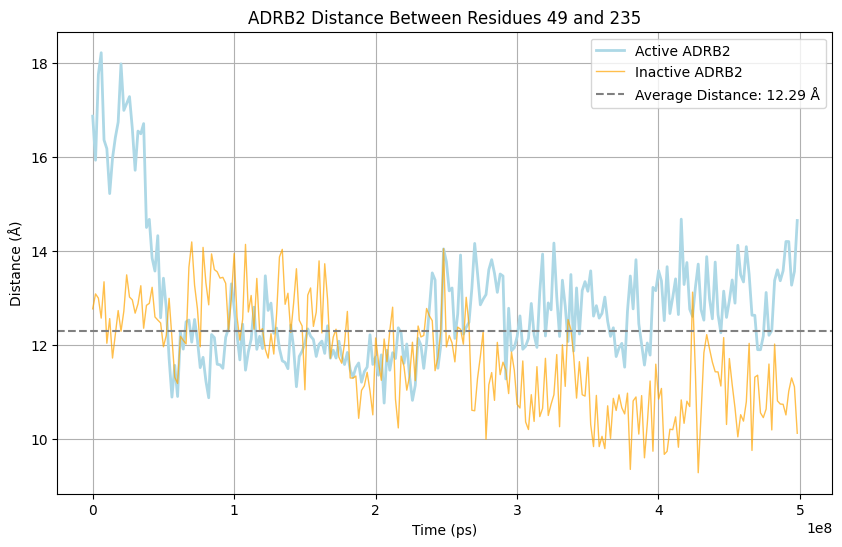

In [12]:
compute_and_plot_distances("traj1_active", "traj1_inActive", "ADRB2")

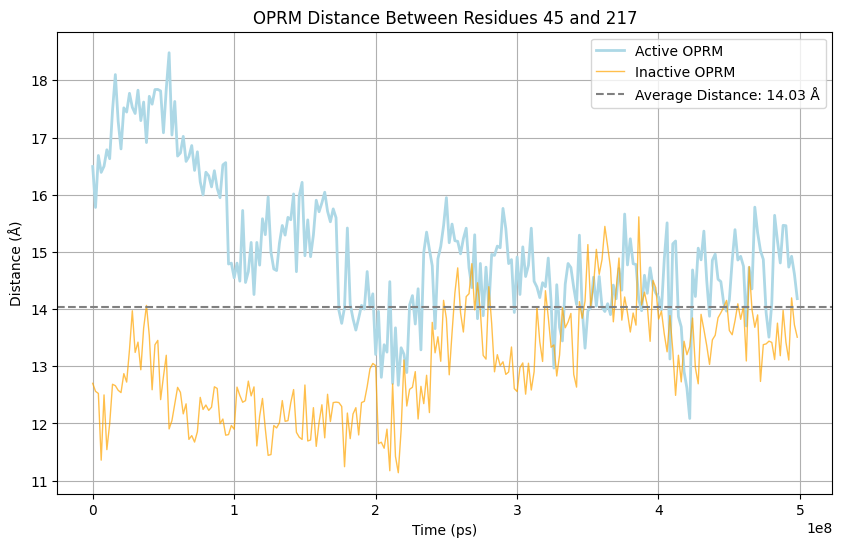

In [13]:
# Apply the function for both OPRM
compute_and_plot_distances("traj2_active", "traj2_inActive", "OPRM")

### RMSD Calculation

In [14]:
# Initialize the AlignerConsensus using GPCR labels and trajectories
maps = {
    "traj1_active": mdciao.nomenclature.LabelerGPCR("adrb2_human", scheme="BW", write_to_disk= True),
    "traj1_inActive": mdciao.nomenclature.LabelerGPCR("adrb2_human", scheme="BW", write_to_disk= True),
    "traj2_active": mdciao.nomenclature.LabelerGPCR("oprm_mouse", scheme="BW", write_to_disk= True),
    "traj2_inActive": mdciao.nomenclature.LabelerGPCR("oprm_mouse", scheme="BW", write_to_disk= True)
}

No local file ./adrb2_human.xlsx found, checking online in
https://gpcrdb.org/services/residues/extended/adrb2_human ...done!
Please cite the following reference to the GPCRdb:
 * Kooistra et al, (2021) GPCRdb in 2021: Integrating GPCR sequence, structure and function
   Nucleic Acids Research 49, D335--D343
   https://doi.org/10.1093/nar/gkaa1080
For more information, call mdciao.nomenclature.references()
wrote ./adrb2_human.xlsx for future use
./adrb2_human.xlsx found locally.
No local file ./oprm_mouse.xlsx found, checking online in
https://gpcrdb.org/services/residues/extended/oprm_mouse ...done!
Please cite the following reference to the GPCRdb:
 * Kooistra et al, (2021) GPCRdb in 2021: Integrating GPCR sequence, structure and function
   Nucleic Acids Research 49, D335--D343
   https://doi.org/10.1093/nar/gkaa1080
For more information, call mdciao.nomenclature.references()
wrote ./oprm_mouse.xlsx for future use
./oprm_mouse.xlsx found locally.


#### Define RMSD Analysis Function
Create a function to compute and visualize Root Mean Square Deviation using MDtraj, which helps us understand structural changes over time.

In [21]:
def compute_and_plot_rmsd(
    traj_key,
    ref_key,
    receptor_name,
    traj_state="",  # Active or "inactive"
    ref_state="",   # Active or "inactive"
    step=10
):
    """
    Compute and plot RMSD, with explicit states for both trajectory and reference.
    """
    maps_rmsd = {key: labeler for key, labeler in maps.items()}
    tops_rmsd = {key: traj.top for key, traj in trajectories.items()}
    ref_geom = mdciao.cli.pdb(ref_key)
    ref = ref_geom.atom_slice(ref_geom.topology.select('protein'))

    maps_rmsd.update({ref_key: mdciao.nomenclature.LabelerGPCR(receptor_name, scheme="BW", write_to_disk=True)})
    tops_rmsd.update({ref_key: ref_geom.top})

    AC = mdciao.nomenclature.AlignerConsensus(maps=maps_rmsd, tops=tops_rmsd)
    trajectory = trajectories[traj_key][::step]

    key_CAs, ref_CAs = AC.CAidxs_match("?.*", keys=[traj_key, ref_key])[[traj_key, ref_key]].values.T
    rmsd = md.rmsd(trajectory, ref, atom_indices=key_CAs, ref_atom_indices=ref_CAs) * 10

    times_ps = trajectories[traj_key].time[::step]   

    plt.figure(figsize=(10, 6))
    plt.plot(
        times_ps, rmsd,
        label=f"{traj_state} trajectory ({traj_key})",
        color="#2ecc71",
        linewidth=2
    )
    
    plt.axhline(
        y=0,
        color="#7f7f7f",
        linestyle='--',
        linewidth=2,
        label=f"{ref_state} reference ({ref_key})"
    )

    plt.xlabel("Time (ps)")
    plt.ylabel("RMSD (Å)")
    plt.title(f"{receptor_name} RMSD: {traj_key} ({traj_state}) vs {ref_key} ({ref_state})")
    plt.legend()

    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.gca().set_facecolor('#f8f9fa')
    plt.grid(True, linestyle='--', alpha=0.3)

    plt.show()


Compute and plot RMSD to measure conformational stability/fluctuations within the same state
    (active or inactive). This function calculates how much a trajectory deviates from its
    reference structure of the same state, rather than comparing between different states.
    The alignment and RMSD calculation are performed using mdciao.


#### Applying the RMSD Function to the Active State of ADRB2  
Ensure the selection of an appropriate reference structure. In this example, we used [8GG0](https://gpcrdb.org/structure/8GG0) as a reference.

Checking https://files.rcsb.org/download/8GG0.pdb ...

/Users/ahmedlamloum/miniconda3/envs/gpcr/lib/python3.11/site-packages/mdtraj/formats/pdb/pdbfile.py:206: UserWarning: Unlikely unit cell vectors detected in PDB file likely resulting from a dummy CRYST1 record. Discarding unit cell vectors.
  warnings.warn(


Please cite the following 3rd party publication:
 * Time-resolved cryo-EM of G-protein activation by a GPCR.
   Papasergi-Scott, M.M. et al., Nature 2024
   https://doi.org/10.1038/s41586-024-07153-1
./ADRB2_human.xlsx found locally.


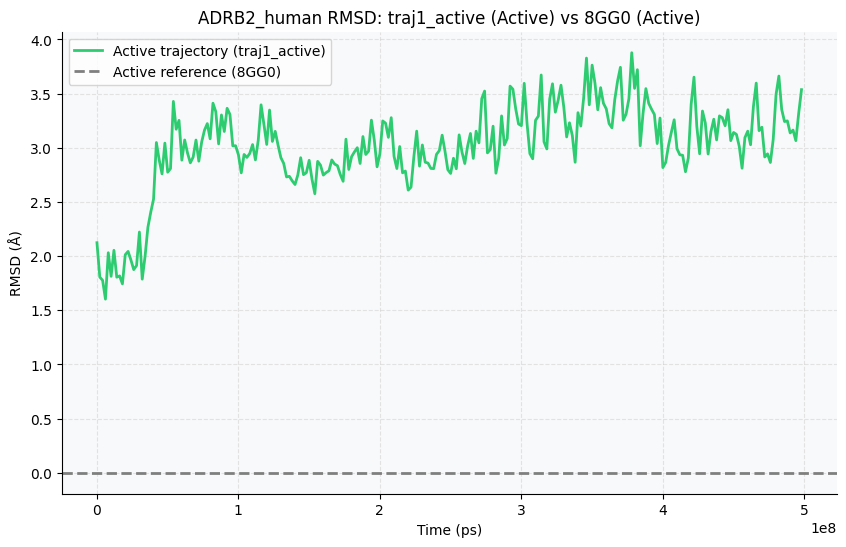

In [22]:
# using active ref as a reference this time to see the result!!
compute_and_plot_rmsd("traj1_active", "8GG0", "ADRB2_human", traj_state="Active", ref_state="Active")

#### Applying the RMSD Function to the inActive State of ADRB2  
Ensure the selection of an appropriate reference structure. In this example, we used [6PS2](https://gpcrdb.org/structure/6PS2) as a reference.

Checking https://files.rcsb.org/download/6PS2.pdb ...Please cite the following 3rd party publication:
 * Toward G protein-coupled receptor structure-based drug design using X-ray lasers.
   Ishchenko, A. et al., IUCrJ 2019
   https://doi.org/10.1107/S2052252519013137
./ADRB2_human.xlsx found locally.


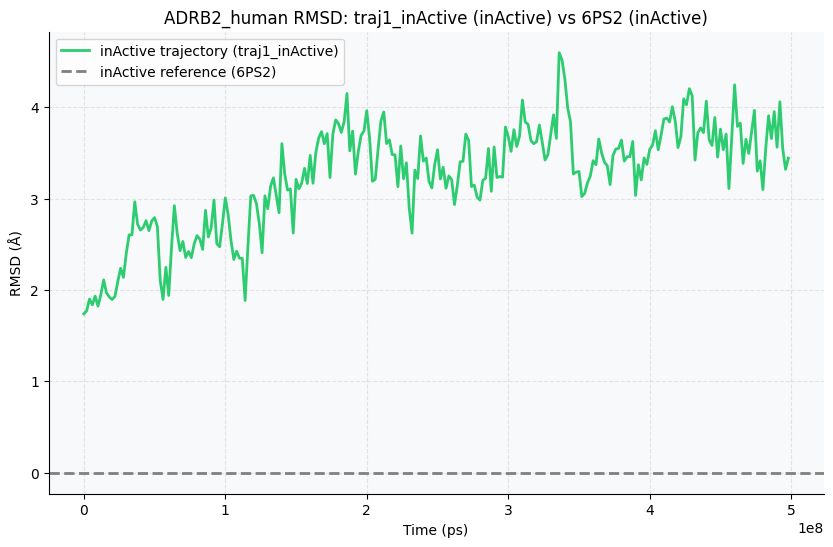

In [25]:
# For ADRB2 inActive trajectory
compute_and_plot_rmsd("traj1_inActive", "6PS2", "ADRB2_human", traj_state="inActive", ref_state="inActive")

- The stabilization around 3.5 A suggests the protein maintains its overall fold while showing normal flexibility
- The gradual increase in RMSD from the reference structure (6PS2) indicates some conformational adaptation, which is expected in MD simulations of GPCRs
- The consistent fluctuations after frame 1000 suggest the simulation has reached a conformationally stable state

#### Applying the RMSD Function to the Active State of OPRM  
Ensure the selection of an appropriate reference structure. In this example, we used [5C1M](https://gpcrdb.org/structure/5C1M) as a reference.

Checking https://files.rcsb.org/download/5C1M.pdb ...Please cite the following 3rd party publication:
 * Structural insights into mu-opioid receptor activation.
   Huang, W. et al., Nature 2015
   https://doi.org/10.1038/nature14886
./OPRM_MOUSE.xlsx found locally.


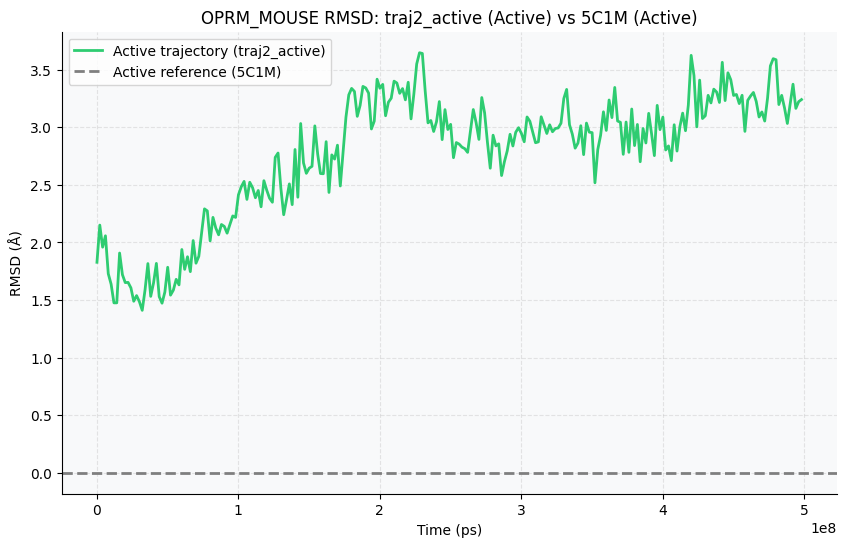

In [26]:
# comnpute RMSD For OPRM active trajectory
# Using the same trajectory as a reference because there are no active OPRM structures in GPCRmd to be used as a reference.
compute_and_plot_rmsd("traj2_active", "5C1M", "OPRM_MOUSE", traj_state="Active", ref_state="Active") 

**Comparison between active and inactive trajectories**

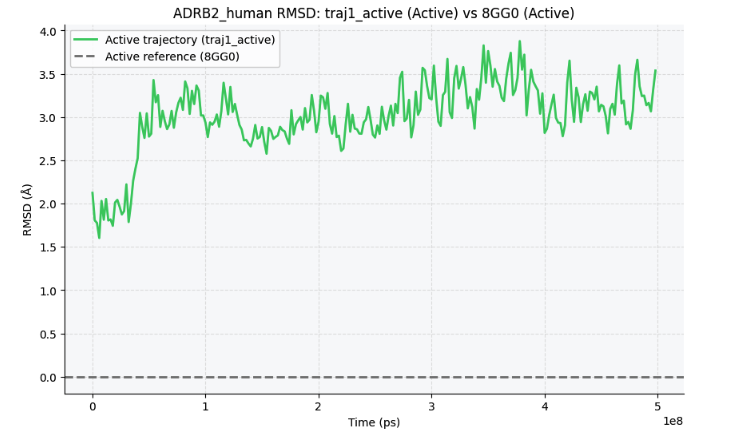 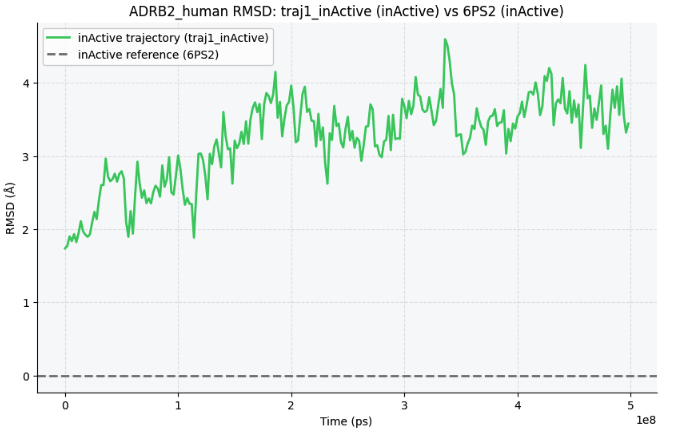

#### Applying the RMSD Function to the inActive State of OPRM  
Ensure the selection of an appropriate reference structure. In this example, we used [4DKL](https://gpcrdb.org/structure/4DKL) as a reference.

Checking https://files.rcsb.org/download/4DKL.pdb ...Please cite the following 3rd party publication:
 * Crystal structure of the {mu}-opioid receptor bound to a morphinan antagonist.
   Manglik, A. et al., Nature 2012
   https://doi.org/10.1038/nature10954
./OPRM_MOUSE.xlsx found locally.


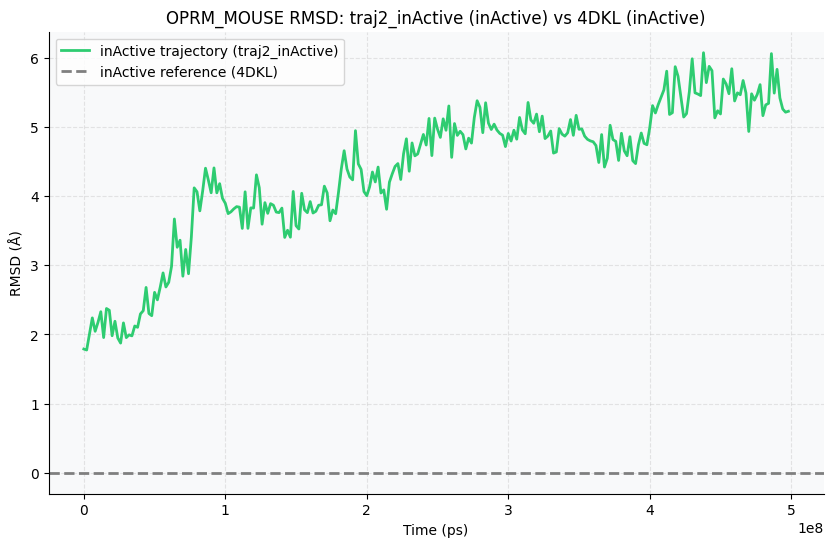

In [27]:
# comnpute RMSD For OPRM inActive trajectory
compute_and_plot_rmsd("traj2_inActive", "4DKL", "OPRM_MOUSE", traj_state="inActive", ref_state="inActive")

### Defining a Comparative RMSD Function to Visualize and Compare the Active and Inactive States of a Receptor Family

In [59]:
def compute_and_plot_comparative_rmsd(traj_key1, ref_key1, traj_key2, ref_key2, receptor_name, step=10):
    """
    Compute and plot RMSD to compare conformational stability/fluctuations between two trajectories of the same receptor.
    Each trajectory is compared against its own reference structure using mdciao for alignment.
    
    Parameters:
        traj_key1, traj_key2 : str
            Keys for the trajectories in the trajectories dictionary.
        ref_key1, ref_key2 : str
            Keys for the reference structures in the maps dictionary.
        receptor_name : str
            Name of the receptor (e.g., "ADRB2").
        step : int
            Frame reduction factor (default: 10, i.e., analyze every 10th frame).
    """
    # Create AlignerConsensus object with updated maps and tops
    maps_rmsd = {key: labeler for key, labeler in maps.items()}
    tops_rmsd = {key: traj.top for key, traj in trajectories.items()}
    
    # Process first trajectory and reference
    ref_geom1 = mdciao.cli.pdb(ref_key1)
    ref1 = ref_geom1.atom_slice(ref_geom1.topology.select('protein'))
    maps_rmsd.update({ref_key1: mdciao.nomenclature.LabelerGPCR(receptor_name, scheme="BW", write_to_disk=True)})
    tops_rmsd.update({ref_key1: ref_geom1.top})

    # Process second trajectory and reference
    ref_geom2 = mdciao.cli.pdb(ref_key2)
    ref2 = ref_geom2.atom_slice(ref_geom2.topology.select('protein'))
    maps_rmsd.update({ref_key2: mdciao.nomenclature.LabelerGPCR(receptor_name, scheme="BW", write_to_disk=True)})
    tops_rmsd.update({ref_key2: ref_geom2.top})
    
    # Create AlignerConsensus object
    AC = mdciao.nomenclature.AlignerConsensus(maps=maps_rmsd, tops=tops_rmsd)
    
    # Get trajectories
    trajectory1 = trajectories[traj_key1][::step]
    trajectory2 = trajectories[traj_key2][::step]
    
    # Get matching CA indices for alignment
    key_CAs1, ref_CAs1 = AC.CAidxs_match("?.*", keys=[traj_key1, ref_key1])[[traj_key1, ref_key1]].values.T
    key_CAs2, ref_CAs2 = AC.CAidxs_match("?.*", keys=[traj_key2, ref_key2])[[traj_key2, ref_key2]].values.T
    
    # Calculate RMSD and convert to Å
    rmsd1 = md.rmsd(trajectory1, ref1, atom_indices=key_CAs1, ref_atom_indices=ref_CAs1) * 10
    rmsd2 = md.rmsd(trajectory2, ref2, atom_indices=key_CAs2, ref_atom_indices=ref_CAs2) * 10
    
    # Convert x-axis from frames to time (ps)
    time1_ps = trajectories[traj_key1].time[::step]
    time2_ps = trajectories[traj_key2].time[::step]
    
    # Plot results
    plt.figure(figsize=(12, 7))
    
    plt.plot(time1_ps, rmsd1, 
             label=f'traj: {traj_key1}, ref: {ref_key1}', 
             color="#3D84A8", 
             linewidth=2)
    
    plt.plot(time2_ps, rmsd2, 
             label=f'traj: {traj_key2}, ref: {ref_key2}', 
             color="#FFAAA5", 
             linewidth=2)
    
    plt.axhline(y=0, 
                color="#7f7f7f", 
                linestyle='--', 
                linewidth=2, 
                label="Reference Line")

    plt.xlabel("Time (ps)")
    plt.ylabel("RMSD (Å)")
    plt.title(f"Comparative RMSD for {receptor_name} in active and inActive state")
    plt.legend()
    
    # Style improvements
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.gca().set_facecolor('#f8f9fa')
    plt.grid(True, linestyle='--', alpha=0.3)
    
    # plt.savefig(f"images/{receptor_name.lower()}_comparative_rmsd_plot.png")
    plt.show()


#### Applying the comparitive function to ADRB2 Recptor

Checking https://files.rcsb.org/download/8GG0.pdb ...

/Users/ahmedlamloum/miniconda3/envs/gpcr/lib/python3.11/site-packages/mdtraj/formats/pdb/pdbfile.py:206: UserWarning: Unlikely unit cell vectors detected in PDB file likely resulting from a dummy CRYST1 record. Discarding unit cell vectors.
  warnings.warn(


Please cite the following 3rd party publication:
 * Time-resolved cryo-EM of G-protein activation by a GPCR.
   Papasergi-Scott, M.M. et al., Nature 2024
   https://doi.org/10.1038/s41586-024-07153-1
./ADRB2_human.xlsx found locally.
Checking https://files.rcsb.org/download/6PS2.pdb ...Please cite the following 3rd party publication:
 * Toward G protein-coupled receptor structure-based drug design using X-ray lasers.
   Ishchenko, A. et al., IUCrJ 2019
   https://doi.org/10.1107/S2052252519013137
./ADRB2_human.xlsx found locally.


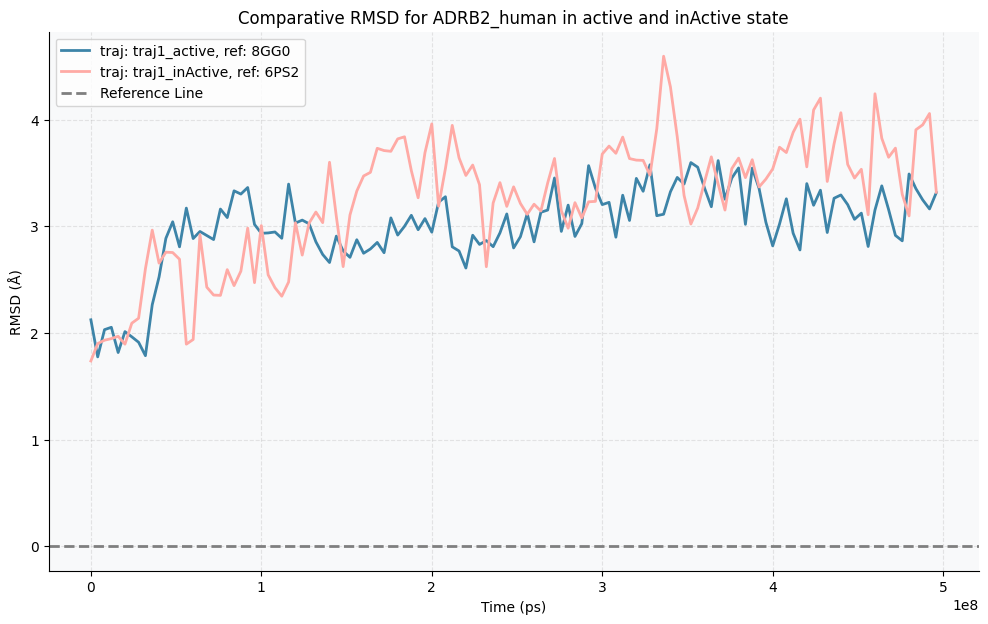

In [60]:
# Apply to compare ADRB2 and OPRM trajectories in active stat ... 
compute_and_plot_comparative_rmsd("traj1_active", "8GG0",
                                  "traj1_inActive", "6PS2", 
                                  "ADRB2_human", step=20)

### Root Mean Square Fluctuation (RMSF)  
RMSF analysis measures the flexibility of protein residues over the course of a simulation, providing insights into dynamic structural changes.

In [76]:
def compute_and_plot_rmsf(traj_key, ref_key, receptor_name, step=1):
    """
    Compute and plot RMSF to identify flexible regions in the protein structure.
    The calculation is performed on CA atoms using mdciao for alignment.

    Parameters
    ----------
    traj_key : str
        Key identifier for the trajectory in the trajectories dictionary. This trajectory 
        will be analyzed for RMSF calculation.
    
    ref_key : str
        Key identifier for the reference structure in the trajectories dictionary. 
        This structure will be used as the reference for alignment.
    
    receptor_name : str
        Name of the receptor being analyzed. This will be used for labeling and 
        plot titles (e.g., "5HT2A_human").
    
    step : int, optional
        Stride/step size for trajectory analysis. Every nth frame will be used,
        where n is the step value. Default is 1 (use all frames).

    Returns
    -------
    None
        The function creates and displays a plot of RMSF values and prints
        statistical information about the RMSF distribution.
    """
    # Create AlignerConsensus object with updated maps and tops
    maps_rmsd = {key: labeler for key, labeler in maps.items()}
    tops_rmsd = {key: traj.top for key, traj in trajectories.items()}
    
    # Retrieve and Prepare reference structure (protein only)
    ref_geom = mdciao.cli.pdb(ref_key)
    ref = ref_geom.atom_slice(ref_geom.topology.select('protein and name CA'))
    
    # Add reference structure to maps and tops
    maps_rmsd.update({ref_key: mdciao.nomenclature.LabelerGPCR(f"{receptor_name}", scheme="BW", write_to_disk=True)})
    tops_rmsd.update({ref_key: ref_geom.top})
        
    # Get the trajectory and select CA atoms only
    trajectory = trajectories[traj_key][::step]
    traj_ca = trajectory.atom_slice(trajectory.topology.select('protein and name CA'))
    
    # Calculate RMSF using MDTraj's rmsf function
    # First align the trajectory to its average structure
    traj_ca.superpose(traj_ca, frame=0)
    rmsf = md.rmsf(traj_ca, traj_ca[0])
    
    # Get residue numbers and names for x-axis
    topology = traj_ca.topology
    residues = [f"{r.resSeq}{r.name}" for r in topology.residues]
    
    # Plot results
    plt.figure(figsize=(15, 6))
    
    # Plot the RMSF
    plt.plot(range(len(rmsf)), rmsf, 
             label=f'{receptor_name} RMSF', 
             color="#2ecc71", 
             linewidth=2)
    
    # Add regions of interest annotations
    plt.axhline(y=np.mean(rmsf), color='gray', linestyle='--', alpha=0.5, label='Mean RMSF')
    
    # Customize plot
    plt.xlabel("Residue Number")
    plt.ylabel("RMSF (nm)")
    plt.title(f"{receptor_name} Root Mean Square Fluctuation")
    
    # Add residue labels (every 20th residue)
    n_residues = len(residues)
    tick_positions = range(0, n_residues, 20)
    plt.xticks(tick_positions, [residues[i] for i in tick_positions], rotation=45, ha='right')
    
    # Style improvements
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    plt.gca().set_facecolor('#f8f9fa')
    plt.grid(True, linestyle='--', alpha=0.3)
    
    # Add legend
    plt.legend(loc='upper right')
    
    # Adjust layout to prevent label cutoff
    plt.tight_layout()
    
    # Print some statistics
    print("\n" ,"-" * 25, "\n")
    print(f"Average RMSF: {np.mean(rmsf):.3f} nm")
    print(f"Maximum RMSF: {np.max(rmsf):.3f} nm at residue {residues[np.argmax(rmsf)]}")
    print(f"Minimum RMSF: {np.min(rmsf):.3f} nm at residue {residues[np.argmin(rmsf)]}")
    print("\n" ,"-" * 25, "\n")
    
    plt.show()

Root mean square fluctuation plot (RMSF). The X axis represents the residues of the primary sequence. The Y axis quantifies the corresponding movement of each residue measured in [Å]. The higher the Y value, the higher the mobility of adjacent residues in segment of the protein. The four combinations of the liganded / unliganded pair are color coded

#### Applying RMSF function to ADRB2 Active state
Ensure the selection of an appropriate reference structure. In this example, we used [8GG0](https://gpcrdb.org/structure/8GG0) as a reference.

Checking https://files.rcsb.org/download/8GG0.pdb ...

/Users/ahmedlamloum/miniconda3/envs/gpcr/lib/python3.11/site-packages/mdtraj/formats/pdb/pdbfile.py:206: UserWarning: Unlikely unit cell vectors detected in PDB file likely resulting from a dummy CRYST1 record. Discarding unit cell vectors.
  warnings.warn(


Please cite the following 3rd party publication:
 * Time-resolved cryo-EM of G-protein activation by a GPCR.
   Papasergi-Scott, M.M. et al., Nature 2024
   https://doi.org/10.1038/s41586-024-07153-1
./ADRB2_human.xlsx found locally.

 ------------------------- 

Average RMSF: 0.165 nm
Maximum RMSF: 1.058 nm at residue 257GLY
Minimum RMSF: 0.073 nm at residue 209TYR

 ------------------------- 



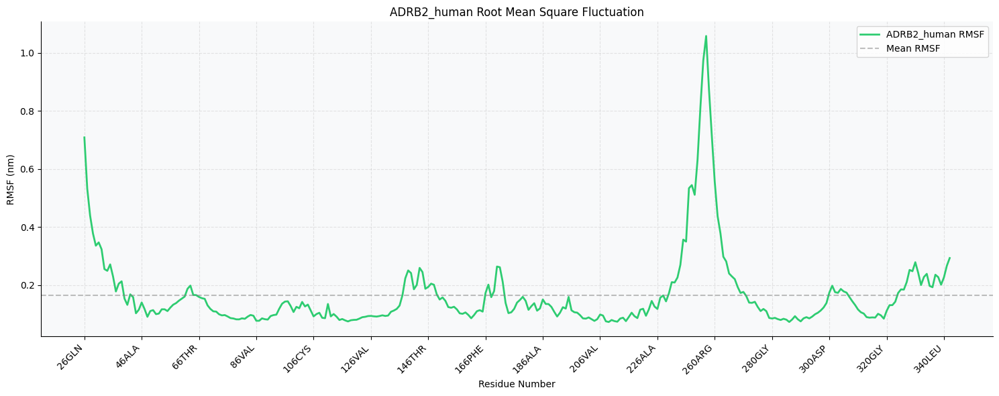

In [77]:
# Compute and plot RMSF for ADRB2
compute_and_plot_rmsf("traj1_active", "8GG0", "ADRB2_human")

#### Applying RMSF function to ADRB2 inActive state
Ensure the selection of an appropriate reference structure. In this example, we used [6PS2](https://gpcrdb.org/structure/6PS2) as a reference.

Checking https://files.rcsb.org/download/6PS2.pdb ...Please cite the following 3rd party publication:
 * Toward G protein-coupled receptor structure-based drug design using X-ray lasers.
   Ishchenko, A. et al., IUCrJ 2019
   https://doi.org/10.1107/S2052252519013137
./ADRB2_human.xlsx found locally.

 ------------------------- 

Average RMSF: 0.174 nm
Maximum RMSF: 1.253 nm at residue 242VAL
Minimum RMSF: 0.071 nm at residue 115LEU

 ------------------------- 



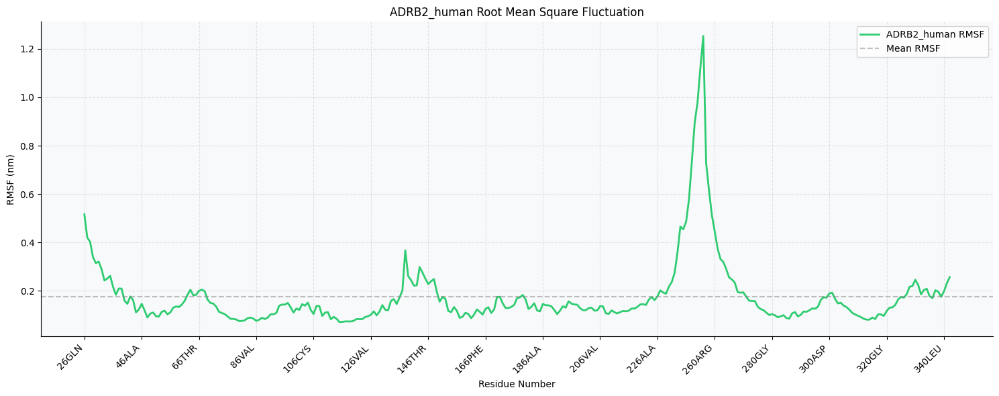

In [80]:
# Compute and plot RMSF for ADRB2
compute_and_plot_rmsf("traj1_inActive", "6PS2", "ADRB2_human")

#### Compute and plot RMSF for OPRM Active State
Ensure the selection of an appropriate reference structure. In this example, we used [5C1M](https://gpcrdb.org/structure/5C1M) as a reference.

Checking https://files.rcsb.org/download/5C1M.pdb ...Please cite the following 3rd party publication:
 * Structural insights into mu-opioid receptor activation.
   Huang, W. et al., Nature 2015
   https://doi.org/10.1038/nature14886
./OPRM_MOUSE.xlsx found locally.

 ------------------------- 

Average RMSF: 0.138 nm
Maximum RMSF: 0.688 nm at residue 266SER
Minimum RMSF: 0.056 nm at residue 115ALA

 ------------------------- 



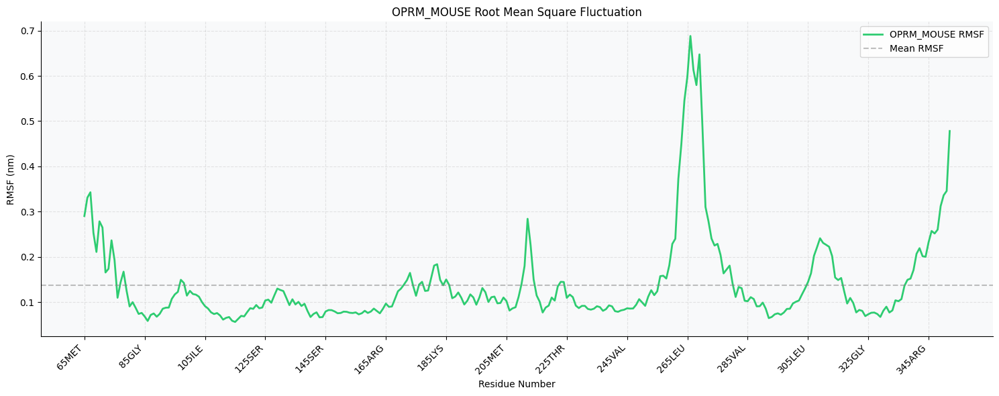

In [81]:
compute_and_plot_rmsf("traj2_active", "5C1M", "OPRM_MOUSE") 

#### Compute and plot RMSF for OPRM inActive State
Ensure the selection of an appropriate reference structure. In this example, we used [4DKL](https://gpcrdb.org/structure/4DKL) as a reference.

Checking https://files.rcsb.org/download/4DKL.pdb ...Please cite the following 3rd party publication:
 * Crystal structure of the {mu}-opioid receptor bound to a morphinan antagonist.
   Manglik, A. et al., Nature 2012
   https://doi.org/10.1038/nature10954
./OPRM_MOUSE.xlsx found locally.

 ------------------------- 

Average RMSF: 0.212 nm
Maximum RMSF: 0.694 nm at residue 307THR
Minimum RMSF: 0.066 nm at residue 111ALA

 ------------------------- 



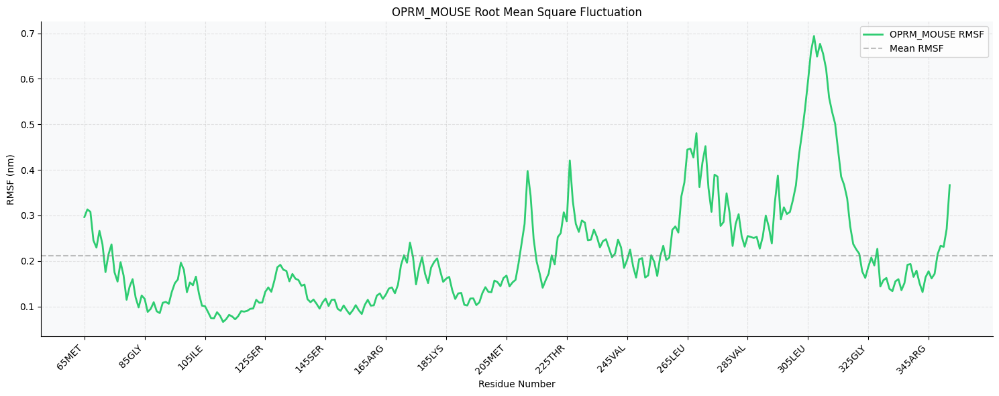

In [82]:
compute_and_plot_rmsf("traj2_inActive", "4DKL", "OPRM_MOUSE")

Maximum RMSF: 1.144 nm at residue 257GLY which located in Intracellular loop 3 (ICL3) connects TM5 and TM6 \
a maximum RMSF value of 1.144 nm at residue 257GLY (Glycine 257) is significant because:\

1. Location and Function:\
GLY257 is located in the third intracellular loop (ICL3) of ADRB2 
ICL3 is crucial for:
    - G-protein coupling
    - β-arrestin binding
    - Signal transduction
2. Significance of High RMSF:\
The high RMSF (1.144 nm) indicates:
    - This region is highly flexible
    - Undergoes large conformational changes
    - Important for receptor function during activation/deactivation

------

## Discussion

The molecular dynamics (MD) analysis of GPCRs has presented distinguishable insights of the structural and functional flexibility of the receptors, specifically their activation and signaling mechanisms. 
In this talktorial, we investigate key features of GPCR dynamics using following approaches:

1. 3D animated visualization and structural alignment:
   This methedology enabled us to visualize and compare the receptor conformations     through out the activation states and ligand binding states. These GPCR             simulaztions enables us to prove that the movemen and the interation within the     different parts of the receptor shows the flexibility of structure which is         necessary for GPCR signalling.

2. Root Mean Square Deviation (RMSD) and Root Mean Square Fluctuation (RMSF):
   The RMSD gave a quantitative measure of the entire conformational stability on      the other hand RMSF displayed residue-level flexibility. These benchmarks           assisted in  identifiying critical region that aids to receptor activation and      ligand specificity.

### Implications for drug discovery 
 - Design the ligands with tailored signaling
 - Recognize allosteric sites for novel drugs
 - Studies involved receptor responses to mutations or external stimuli

## Quiz
1. What is the main purpose of the TeachOpenCADD platform, and how does it facilitate the teaching of domain-specific skills in the context of molecular dynamics simulations?
2. Why is it important to study GPCR dynamics rather than relying solely on static structures from techniques like X-ray crystallography or cryo-EM?
3. How can contact analysis and RMSF data be used together to identify potential allosteric sites or regions important for receptor modulation?